In [1]:
### Import libraries

import pandas as pd
import igraph as ig
import auxiliar_path
import numpy as np
### K-modes algorithm
from kmodes import KModes
import matplotlib.pyplot as plt

In [2]:
### Global variables
### Global variables

DATASET = "AMZ" # AMZ, HC, PM, UN, TOY
NODE_TYPE = True

PATH_DATASET = auxiliar_path.get_path_dataset(DATASET)
PATH_NODETYPE = auxiliar_path.get_path_topbot(NODE_TYPE)

GLOBAL_PATH = "/Users/ddiaz/Documents/code/phd-thesis-lab/"

# File CSV
FILENAME = GLOBAL_PATH + "12-third_year/00-Data/"+PATH_DATASET+"/01-DistributionsCSV/"+DATASET+"-MOD.csv"

In [3]:
### Read CSV

df = pd.read_csv(FILENAME)

# Remove noisy column
#df = df.drop(columns=["Unnamed: 0"])
print(df.info()) # Info
print()


# Some information about access requests
n_user = len(df.uname.drop_duplicates())
n_rscs = len(df.rname.drop_duplicates())
print(f"|U| = {n_user}")
print(f"|R| = {n_rscs}")
print(f"|U+R| = {n_user+n_rscs}")
print()

# Possible edges
n_acc_res = len(df.drop_duplicates(["uname", "rname"]))
df_pos = df[df.ACTION == 1]
n_ar_pos = len(df_pos.drop_duplicates())
n_ar_neg = len(df[df.ACTION == 0].drop_duplicates())

print(f"|L| = {n_acc_res}")
print(f"|L+| = {n_ar_pos}")
print(f"|L-| = {n_ar_neg}")
print()

if n_acc_res == n_ar_pos+n_ar_neg:
    print("*"*43)
    print("** CORRECT FLAG: Same number L = L+ + L- **")
    print("*"*43)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65538 entries, 0 to 65537
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype
---  ------            --------------  -----
 0   ACTION            65538 non-null  int64
 1   rname             65538 non-null  int64
 2   MGR_ID            65538 non-null  int64
 3   ROLE_ROLLUP_1     65538 non-null  int64
 4   ROLE_ROLLUP_2     65538 non-null  int64
 5   ROLE_DEPTNAME     65538 non-null  int64
 6   ROLE_TITLE        65538 non-null  int64
 7   ROLE_FAMILY_DESC  65538 non-null  int64
 8   ROLE_FAMILY       65538 non-null  int64
 9   ROLE_CODE         65538 non-null  int64
 10  uname             65538 non-null  int64
dtypes: int64(11)
memory usage: 5.5 MB
None

|U| = 9561
|R| = 7518
|U+R| = 17079

|L| = 32769
|L+| = 30872
|L-| = 1897

*******************************************
** CORRECT FLAG: Same number L = L+ + L- **
*******************************************


In [4]:
### GLOBAL variables

GRAPH_PATH = "/Users/ddiaz/Documents/code/phd-thesis-lab/12-third_year/00-Data/01-AMZ/02-Graphs/01-Top/AMZ_top_resall_DF_alpha2.graphml"
#GRAPH_PATH = "/Users/ddiaz/Documents/code/phd-thesis-lab/12-third_year/00-Data/02-HC/02-Graphs/02-Bot/HC_bot_weights_DF_alpha05.graphml"

In [5]:
### Read GRAPH

g = ig.read(GRAPH_PATH)
print(g.summary(), "\n")

print("Graph info:")
print("\t|V| =", g.vcount())
print("\t|E| =", g.ecount())
print("\t d  =", g.density())

IGRAPH U-WT 9560 162026 -- 
+ attr: freq (v), id (v), type (v), weight (e) 

Graph info:
	|V| = 9560
	|E| = 162026
	 d  = 0.00354604589597921


/Users/ddiaz/Documents/code/envs/tesis/lib/python3.10/site-packages/igraph/io/files.py:295: RuntimeWarning: Could not add vertex ids, there is already an 'id' vertex attribute. at src/io/graphml.c:488
  return reader(f, *args, **kwds)


In [6]:
### Community Detection

comms = g.community_multilevel(weights=g.es["weight"])
g.vs["cls"] = comms.membership
print(comms.summary(), "\n")

Clustering with 9560 elements and 420 clusters 



In [7]:
comms_with_one = [[i,subgraph] for i, subgraph in enumerate(comms.subgraphs()) if len(subgraph.vs) > 5]
len(comms_with_one)

33

In [8]:
comms_with_one[0][1].vcount()

105

In [9]:
def get_filtered_community_sizes_distribution(filtered_comms):
    """
    Get the size distribution of a list of communities.
    filtered_comms: list of list:
        (i, subgraph):
            i = index
            subgraph = community
    """
    size_distri = [c.vcount() for i, c in filtered_comms]
    return size_distri

In [10]:

# Select the number of clusters###
num_clusters = len(comms_with_one)

#DO NOT CHANGE THIS CODE
# seed = 29

#Compute centroids and labels
# num_init = 5
centroids = []
kmodes_huang = KModes(n_clusters=num_clusters, init='Huang', verbose=0)
cluster_labels = kmodes_huang.fit_predict(df_pos.drop(columns=["rname", "uname"]))
centroids = kmodes_huang.cluster_centroids_
df_pos["cls"] = cluster_labels
print('Ready!')   

Ready!


/var/folders/g4/vgr09c9n7pd31lk61zpr3_440000gn/T/ipykernel_7949/3816161329.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pos["cls"] = cluster_labels


In [11]:
len(df_pos["cls"].value_counts())

33

<Figure size 640x480 with 0 Axes>

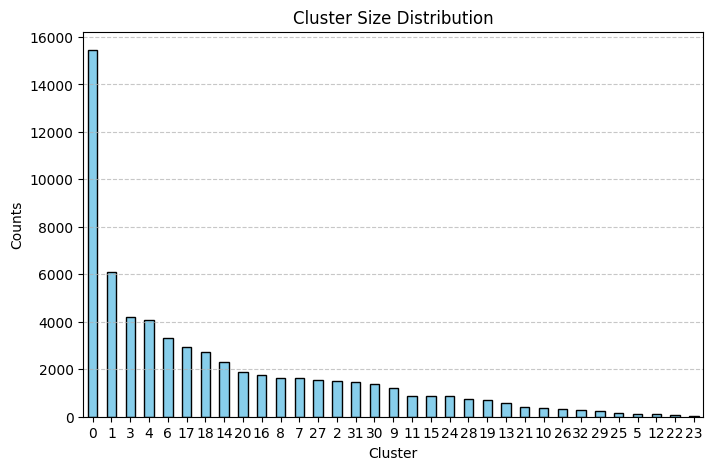

In [12]:
plt.clf()

value_counts = df_pos["cls"].value_counts()
# Plot
plt.figure(figsize=(8, 5))
value_counts.plot(kind='bar', color='skyblue', edgecolor='black')
plt.xlabel('Cluster')
plt.ylabel('Counts')
plt.title('Cluster Size Distribution')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show the plot
plt.show()

In [13]:
# Obtener la cantidad de usuarios por nodo
user_per_cluster = []
for i in range(max(df_pos["cls"])):
    usuarios_cluster = df_pos[df_pos["cls"]==i]["rname"].drop_duplicates()
    user_per_cluster.append(len(usuarios_cluster))
print(user_per_cluster)


[2122, 1510, 476, 1232, 569, 35, 655, 487, 300, 318, 108, 298, 30, 229, 675, 249, 410, 447, 868, 117, 319, 159, 20, 7, 309, 53, 116, 325, 238, 83, 352, 443]


<Figure size 640x480 with 0 Axes>

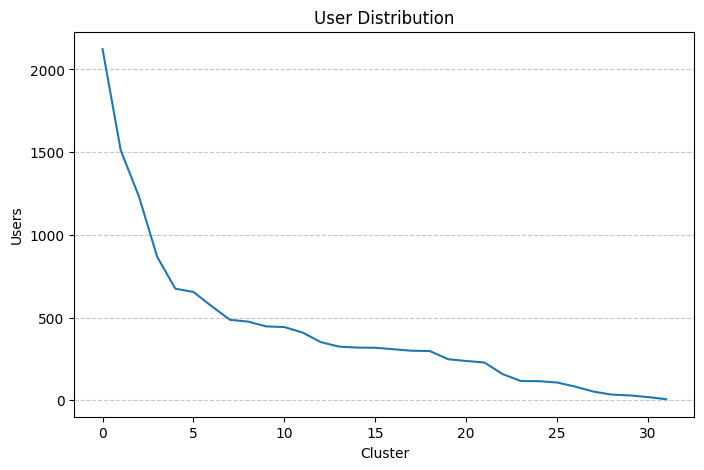

In [14]:
plt.clf()
# Plot
plt.figure(figsize=(8, 5))
plt.plot(sorted(user_per_cluster, reverse=True))
plt.xlabel('Cluster')
plt.ylabel('Users')
plt.title('User Distribution')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
# Show the plot
plt.show()

TypeError: float() argument must be a string or a real number, not 'Graph'

<Figure size 640x480 with 0 Axes>

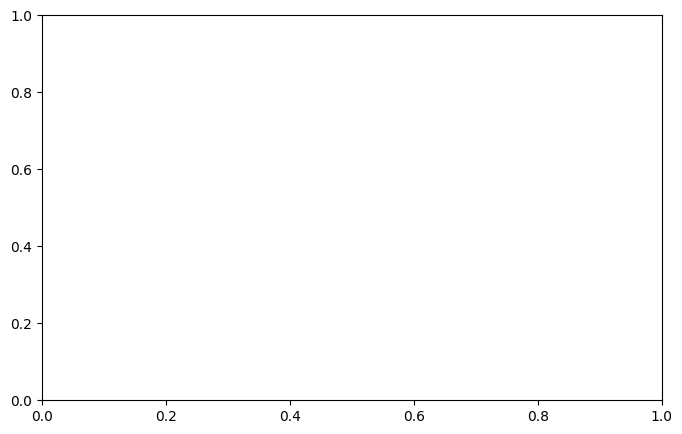

In [15]:
plt.clf()
asd = pd.DataFrame()
value_counts = comms_with_one
# Plot
plt.figure(figsize=(8, 5))
plt.plot(sorted(comms_with_one, reverse=True))
plt.xlabel('Community')
plt.ylabel('Counts')
plt.title('Community Size Distribution')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
# Show the plot
plt.show()

In [16]:
def get_neis_comms(graph, not_in):
    dict_user = dict()
    for user in graph.vs():
        cluster_ = user["cls"]
        if not cluster_ in not_in:
            neis_user = list(graph.vs.select(cls_eq=cluster_)["id"])
            neis_user = set([int(x) for x in neis_user])
            dict_user[int(user["id"])] = neis_user
    return dict_user

In [17]:
comms_with_one = [i for i, subgraph in enumerate(comms.subgraphs()) if len(subgraph.vs) <= 5]
dict_res_comms = get_neis_comms(g, comms_with_one)
dict_res_comms

{0: {0,
  23,
  247,
  254,
  417,
  517,
  555,
  558,
  573,
  689,
  709,
  748,
  774,
  891,
  1020,
  1055,
  1190,
  1194,
  1255,
  1312,
  1408,
  1590,
  1705,
  1782,
  1850,
  1872,
  1896,
  1951,
  1958,
  1997,
  2120,
  2122,
  2170,
  2182,
  2283,
  2359,
  2361,
  2394,
  2639,
  3054,
  3097,
  3177,
  3185,
  3202,
  3209,
  3218,
  3432,
  3485,
  3585,
  3802,
  4122,
  4158,
  4263,
  4337,
  4348,
  4383,
  4385,
  4391,
  4413,
  4444,
  4500,
  4778,
  4788,
  4939,
  4967,
  5065,
  5160,
  5179,
  5246,
  5403,
  5543,
  5571,
  5650,
  5668,
  5671,
  5734,
  5819,
  5844,
  5880,
  5890,
  5945,
  5988,
  6230,
  6368,
  6411,
  6460,
  6818,
  6959,
  7203,
  7212,
  7423,
  7466,
  7586,
  7611,
  7635,
  7764,
  7881,
  7969,
  8265,
  8281,
  8467,
  8582,
  8925,
  9243,
  9308},
 1: {1,
  21,
  22,
  27,
  59,
  105,
  114,
  116,
  124,
  131,
  155,
  166,
  168,
  187,
  194,
  217,
  220,
  248,
  255,
  278,
  312,
  326,
  339,
  351,
  359,
 

In [62]:
dict_res

{12611: {12289,
  16388,
  12298,
  12305,
  12313,
  12314,
  16410,
  16414,
  12320,
  12325,
  16422,
  12329,
  12330,
  16427,
  16428,
  12332,
  12334,
  16439,
  12348,
  12364,
  16463,
  16467,
  16477,
  12383,
  12386,
  12388,
  16492,
  16496,
  12403,
  16503,
  12409,
  16514,
  16515,
  12423,
  12424,
  16521,
  16522,
  16523,
  16526,
  16529,
  16533,
  16537,
  16540,
  16541,
  12448,
  16549,
  16563,
  16578,
  16591,
  16592,
  16594,
  12498,
  12499,
  12502,
  16599,
  12504,
  16600,
  12503,
  16607,
  12517,
  16614,
  12518,
  12521,
  16619,
  12525,
  16629,
  16630,
  12535,
  12536,
  16634,
  12539,
  16636,
  16637,
  12542,
  12550,
  12551,
  16648,
  16650,
  12557,
  16654,
  16660,
  16661,
  12569,
  16666,
  16669,
  16671,
  16676,
  16680,
  12586,
  12587,
  12588,
  12589,
  12592,
  12596,
  16693,
  16692,
  16696,
  12602,
  16698,
  16700,
  12605,
  12604,
  12611,
  12612,
  12613,
  12615,
  16712,
  16711,
  12619,
  16716,
  1

In [68]:
list_cluster_check = []
for i in range(max(df_pos["cls"])):
    temp = df_pos[df_pos["cls"]==i]
    if len(temp["uname"].drop_duplicates()) <= 5:
        list_cluster_check.append(i)

list_cluster_check = set(list_cluster_check)
list_cluster_check, len(list_cluster_check)

({22, 28}, 2)

In [61]:
### Implementar la función para obtener todos los vecinos

def get_neis(data, cluster_avoid):
    """Get the nodes in the same cluster."""
    dict_user = dict()
    dict_res = dict()
    for user in data.uname.drop_duplicates():
        all_clusters = set(data[data.uname==user]["cls"])
        all_clusters = all_clusters.difference(cluster_avoid)
        neis_user = set()
        for cls in all_clusters:
            neis_user = neis_user.union(set(data[data.cls==cls]["uname"]))
        dict_user[user] = neis_user
    
    for res in data.rname.drop_duplicates():
        all_clusters = set(data[data.rname==res]["cls"])
        all_clusters = all_clusters.difference(cluster_avoid)
        neis_user = set()
        for cls in all_clusters:
            neis_user = neis_user.union(set(data[data.cls==cls]["rname"]))
        dict_res[res] = neis_user
    
    return dict_user, dict_res

dict_user, dict_res = get_neis(df_pos, list_cluster_check)

In [27]:
a = list(g.vs.select(cls_eq=33))
for i in a:
    print(int(i["id"]))

169
237
353
384
469
503
571
645
710
1126
1180
1233
1447
1531
1628
1629
1636
1734
1776
1921
2049
2068
2091
2132
2188
2235
2273
2321
2358
2372
2451
2468
2719
2900
3014
3058
3104
3187
3289
3371
3447
3649
3676
3772
4033
4253
4395
4520
4772
4797
4887
4916
5054
5105
5109
5114
5138
5317
5324
5328
5352
5443
5487
5569
5655
5682
5729
5740
5822
5825
5931
5941
5948
5965
6012
6075
6097
6350
6544
6566
6696
6704
6813
6917
6964
7110
7132
7160
7188
7304
7316
7348
7522
7529
7673
7758
7791
7821
7846
7996
8042
8069
8486
8517
8623
8643
8663
8669
8693
8701
8712
8747
9073
9117
9165
9226
9251
9255
9402
9489
9539


In [40]:
def jaccard_sim(dict_kmodes, dict_louvain):
    dict_resul = {}
    total_mean = []
    for key_, item_ in dict_kmodes.items():
        if key_ in dict_louvain.keys():
            intersec = item_.intersection(dict_louvain[key_])
            set_union = item_.union(dict_louvain[key_])
            jacc_index = len(intersec) / len(set_union)
            dict_resul[key_] = jacc_index
            total_mean.append(jacc_index)
        else:
            continue
    return dict_resul, total_mean

In [63]:
dict_result, jacc_list = jaccard_sim(dict_user, dict_res_comms)


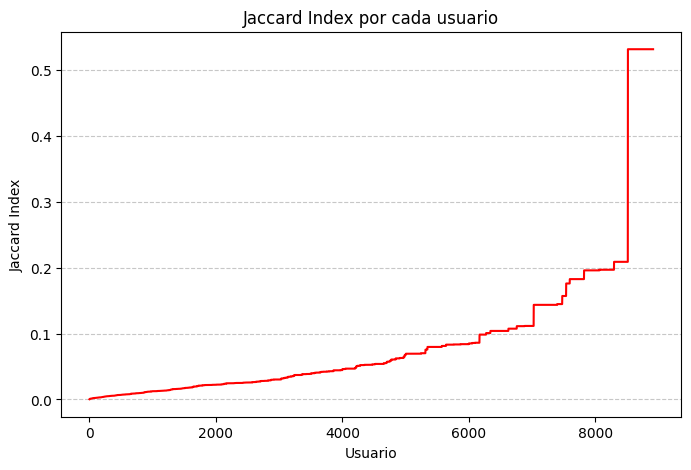

In [64]:
# Extraer claves y valores
# Crear la figura
plt.figure(figsize=(8, 5))
#plt.bar(keys, values, color='skyblue', edgecolor='black')
plt.plot(sorted(jacc_list), color='red')
# Etiquetas y título
plt.xlabel('Usuario')
plt.ylabel('Jaccard Index')
plt.title('Jaccard Index por cada usuario')
plt.xticks(rotation=0)  # Mantiene las etiquetas horizontales
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.show()